# **Neuroengineering Workshop 2021** 
## Deep Learning for CT SuperResolution
***

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!unzip /content/drive/MyDrive/superres_data.zip -d /content/superres_dataset

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Archive:  /content/drive/MyDrive/superres_data.zip
  inflating: /content/superres_dataset/Data/VolumeCT_054_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_057_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_051_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_055_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_053_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_058_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_056_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_052_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_049_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_047_128_128_64.nii  
  inflating: /content/superres_dataset/Data/VolumeCT_046_128_128_64.nii  
  infl

### Environment setup and dependency docking

In [25]:
import os
import sys
import time
import gc
import pickle
import math
from random import shuffle
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.utils.layer_utils import count_params
print(f"Using TensorFlow version: {tf.__version__}")

SEED = 69
tf.random.set_seed(SEED)
print(f"RNG Seed: {SEED}")

tfk = tf.keras
tfkl = tf.keras.layers

Using TensorFlow version: 2.7.0
RNG Seed: 69




### Referencing data and setting up dimensions

In [26]:
ROOT_PATH = '/content/superres_dataset'

# FOLDER TO LOAD DATA FROM
DATA_PATH = os.path.join(ROOT_PATH,'Data')
MODEL_PATH = os.path.join(ROOT_PATH,'Model')

# Volume size
N_ROWS_VOLUME           = 128
N_COLUMNS_VOLUME        = 128
N_SLICES_VOLUME         = 64
NOISE                   = 0.0001 

# Label size
N_ROWS_LABEL            = 256
N_COLUMNS_LABEL         = 256
N_SLICES_LABEL          = 64

# Type
VOLUME_TYPE       = 'nii'

VOLUME_TEMPLATE = "{}/VolumeCT_%s_{}_{}_{}_n{}.{}".format(
    DATA_PATH,
    N_ROWS_VOLUME,
    N_COLUMNS_VOLUME,
    N_SLICES_VOLUME,
    str(NOISE),
    VOLUME_TYPE
    )
LABEL_TEMPLATE = "{}/VolumeCT_%s_{}_{}_{}.{}".format(
    DATA_PATH,
    N_ROWS_LABEL,
    N_COLUMNS_LABEL,
    N_SLICES_LABEL,
    VOLUME_TYPE
    )

# Read available data
AVAILABLE_NUMBER_OF_CASES = 58
try:
    del trainVolumes
    del trainLabels
    del validationVolumes
    del validationLabels
    del testVolumes
    del testLabels
except:
    pass
gc.collect()
volumes_list = []
labels_list = []

for index_case in range(1, AVAILABLE_NUMBER_OF_CASES+1):
    case_id = "{:0>3}".format(index_case)
    volume_path = VOLUME_TEMPLATE % (case_id)
    label_path = LABEL_TEMPLATE % (case_id)
    if (os.path.exists(volume_path) and os.path.exists(label_path)):
        AVAILABLE_NUMBER_OF_CASES += 1
        volumes_list.append(volume_path)
        labels_list.append(label_path)
    else:
        print("Not found")
        print(volume_path)
        print(label_path)

### Train-Validation-Test Splitting

In [30]:
AVAILABLE_NUMBER_OF_CASES = 58
# TRAINING-VALIDATION-TEST PERCENTAGES
TRAINING_PERC_CASES                 = 0.85
VALIDATION_PERC_CASES               = 0.10
TEST_PERC_CASES                     = 1 - TRAINING_PERC_CASES - VALIDATION_PERC_CASES

TRAINING_NUMBER_OF_CASES      = int(AVAILABLE_NUMBER_OF_CASES * TRAINING_PERC_CASES);
VALIDATION_NUMBER_OF_CASES    = int(AVAILABLE_NUMBER_OF_CASES * VALIDATION_PERC_CASES);
TEST_NUMBER_OF_CASES          = AVAILABLE_NUMBER_OF_CASES - TRAINING_NUMBER_OF_CASES - VALIDATION_NUMBER_OF_CASES;
print("Number of cases for training: ",(TRAINING_NUMBER_OF_CASES))
print("Number of cases for validation: " + str(VALIDATION_NUMBER_OF_CASES))
print("Number of cases for testing: " + str(TEST_NUMBER_OF_CASES))
# Training set
trainVolumes = np.empty((TRAINING_NUMBER_OF_CASES, N_ROWS_VOLUME, N_COLUMNS_VOLUME, N_SLICES_VOLUME)) 
trainLabels = np.empty((TRAINING_NUMBER_OF_CASES, N_ROWS_LABEL, N_COLUMNS_LABEL, N_SLICES_LABEL))  
# Validation set
validationVolumes = np.empty((VALIDATION_NUMBER_OF_CASES, N_ROWS_VOLUME, N_COLUMNS_VOLUME, N_SLICES_VOLUME)) 
validationLabels = np.empty((VALIDATION_NUMBER_OF_CASES, N_ROWS_LABEL, N_COLUMNS_LABEL, N_SLICES_LABEL))  
# Training set
testVolumes = np.empty((TEST_NUMBER_OF_CASES, N_ROWS_VOLUME, N_COLUMNS_VOLUME, N_SLICES_VOLUME)) 
testLabels = np.empty((TEST_NUMBER_OF_CASES, N_ROWS_LABEL, N_COLUMNS_LABEL, N_SLICES_LABEL))  

count           = 0
countTraining   = 0
countValidation = 0
countTest       = 0
for volume, label in zip(volumes_list, labels_list):
    if countTraining < TRAINING_NUMBER_OF_CASES:
        # get the refs to training set
        volumes = trainVolumes
        labels  = trainLabels
        index = countTraining
        countTraining += 1
    elif countValidation < VALIDATION_NUMBER_OF_CASES:
        # get the refs to validation set
        volumes = validationVolumes
        labels  = validationLabels
        index = countValidation
        countValidation += 1
    else:
        # get the refs to validation set
        volumes = testVolumes
        labels  = testLabels
        index = countTest
        countTest += 1
    temp = nib.load(label) # loading current label...
    temp = temp.get_fdata()
    temp = np.asarray(temp)
    labels[index, :, :, :] = temp # ...into buffer
    
    temp = nib.load(volume) # loading corresponding volume...
    temp = temp.get_fdata()
    temp = np.asarray(temp)
    volumes[index, :, :, :] = temp # ...into buffer

trainVolumes = trainVolumes.reshape(trainVolumes.shape + (1,)) # necessary to give it as input to model  
validationVolumes = validationVolumes.reshape(validationVolumes.shape + (1,)) # necessary to give it as input to model  
testVolumes = testVolumes.reshape(testVolumes.shape + (1,)) # necessary to give it as input to model

Number of cases for training:  49
Number of cases for validation: 5
Number of cases for testing: 4


In [31]:
trainLabels = trainLabels.reshape(trainLabels.shape + (1,)) # necessary to give it as input to model  
validationLabels = validationLabels.reshape(validationLabels.shape + (1,)) # necessary to give it as input to model  
testLabels = testLabels.reshape(testLabels.shape + (1,)) # necessary to give it as input to model

In [33]:
def slice_volume(volume,slice_size):
    slices = np.zeros((volume.shape[2]//slice_size,volume.shape[0],volume.shape[1],slice_size))
    for l in range(volume.shape[2]//slice_size):
        slices[l,:,:,:] =volume[:,:,l*slice_size:l*slice_size+slice_size,0]
    return slices

SLICE_SIZE = 2

trainVolumes_slice=np.zeros((N_SLICES_VOLUME//SLICE_SIZE*TRAINING_NUMBER_OF_CASES,N_ROWS_VOLUME,N_COLUMNS_VOLUME,SLICE_SIZE))
trainLabels_slice=np.zeros((N_SLICES_LABEL//SLICE_SIZE*TRAINING_NUMBER_OF_CASES,N_ROWS_LABEL,N_COLUMNS_LABEL,SLICE_SIZE))
validationVolumes_slice=np.zeros((N_SLICES_VOLUME//SLICE_SIZE*VALIDATION_NUMBER_OF_CASES,N_ROWS_VOLUME,N_COLUMNS_VOLUME,SLICE_SIZE))
validationLabels_slice=np.zeros((N_SLICES_LABEL//SLICE_SIZE*VALIDATION_NUMBER_OF_CASES,N_ROWS_LABEL,N_COLUMNS_LABEL,SLICE_SIZE))
testVolumes_slice=np.zeros((N_SLICES_VOLUME//SLICE_SIZE*TEST_NUMBER_OF_CASES,N_ROWS_VOLUME,N_COLUMNS_VOLUME,SLICE_SIZE))
testLabels_slice=np.zeros((N_SLICES_LABEL//SLICE_SIZE*TEST_NUMBER_OF_CASES,N_ROWS_LABEL,N_COLUMNS_LABEL,SLICE_SIZE))
for i,vol in enumerate(trainVolumes):
    trainVolumes_slice[i*N_SLICES_LABEL//SLICE_SIZE:i*N_SLICES_LABEL//SLICE_SIZE+N_SLICES_LABEL//SLICE_SIZE,:,:,:]=(slice_volume(vol,SLICE_SIZE))
    trainLabels_slice[i*N_SLICES_VOLUME//SLICE_SIZE:i*N_SLICES_VOLUME//SLICE_SIZE+N_SLICES_VOLUME//SLICE_SIZE,:,:,:]=(slice_volume(trainLabels[i],SLICE_SIZE))
    
for i,vol in enumerate(validationVolumes):
    validationVolumes_slice[i*N_SLICES_LABEL//SLICE_SIZE:i*N_SLICES_LABEL//SLICE_SIZE+N_SLICES_LABEL//SLICE_SIZE,:,:,:]=(slice_volume(vol,SLICE_SIZE))
    validationLabels_slice[i*N_SLICES_LABEL//SLICE_SIZE:i*N_SLICES_LABEL//SLICE_SIZE+N_SLICES_LABEL//SLICE_SIZE,:,:,:]=(slice_volume(validationLabels[i],SLICE_SIZE))
    
for i,vol in enumerate(testVolumes):
    testVolumes_slice[i*N_SLICES_LABEL//SLICE_SIZE:i*N_SLICES_LABEL//SLICE_SIZE+N_SLICES_LABEL//SLICE_SIZE,:,:,:]=(slice_volume(vol,SLICE_SIZE))
    testLabels_slice[i*N_SLICES_LABEL//SLICE_SIZE:i*N_SLICES_LABEL//SLICE_SIZE+N_SLICES_LABEL//SLICE_SIZE,:,:,:]=(slice_volume(testLabels[i],SLICE_SIZE))

print(f"Training Volumes: {trainVolumes.shape}\n--> {trainVolumes_slice.shape} slices")
print(f"Validation Volumes: {validationVolumes.shape}\n--> {validationVolumes_slice.shape} slices")
print(f"Testing Volumes: {testVolumes.shape}\n--> {testVolumes_slice.shape} slices")
print(f"Training Labels: {trainLabels.shape}\n--> {trainLabels_slice.shape} slices")
print(f"Validation Labels: {validationLabels.shape}\n--> {validationLabels_slice.shape} slices")
print(f"Testing Labels: {testLabels.shape}\n--> {testLabels_slice.shape} slices")

Training Volumes: (49, 128, 128, 64, 1)
--> (1568, 128, 128, 2) slices
Validation Volumes: (5, 128, 128, 64, 1)
--> (160, 128, 128, 2) slices
Testing Volumes: (4, 128, 128, 64, 1)
--> (128, 128, 128, 2) slices
Training Labels: (49, 256, 256, 64, 1)
--> (1568, 256, 256, 2) slices
Validation Labels: (5, 256, 256, 64, 1)
--> (160, 256, 256, 2) slices
Testing Labels: (4, 256, 256, 64, 1)
--> (128, 256, 256, 2) slices


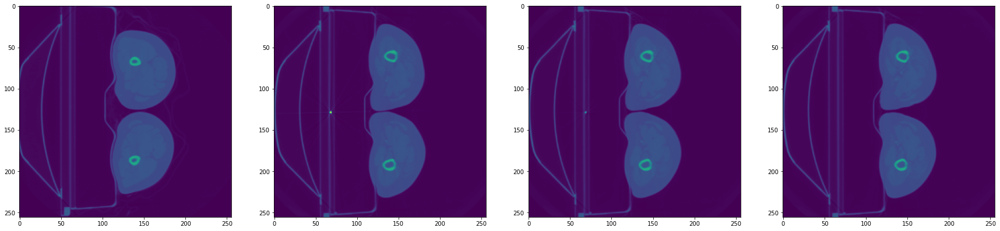

In [ ]:
slice=1
plt.figure(figsize=(30,20));
plt.subplot(1,4,1);
plt.imshow(testLabels_slice[slice,:,:,0],vmin=0,vmax=1);
plt.subplot(1,4,2);
plt.imshow(trainLabels_slice[slice,:,:,1],vmin=0,vmax=1);
plt.subplot(1,4,3);
plt.imshow(trainLabels_slice[slice,:,:,2],vmin=0,vmax=1);
plt.subplot(1,4,4);
plt.imshow(trainLabels_slice[slice,:,:,3],vmin=0,vmax=1);

***

## **Model Definition**

TRAINABLE PARAMETERS:  2.697700e+04
Model: "deltanet_superres"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 128, 128, 2  0           []                               
                                , 1)]                                                             
                                                                                                  
 up_sampling3d_10 (UpSampling3D  (None, 256, 256, 2,  0          ['input_11[0][0]']               
 )                               1)                                                               
                                                                                                  
 conv2d_26 (Conv2D)             (None, 256, 256, 2,  240         ['up_sampling3d_10[0][0]']       
                                 24)          

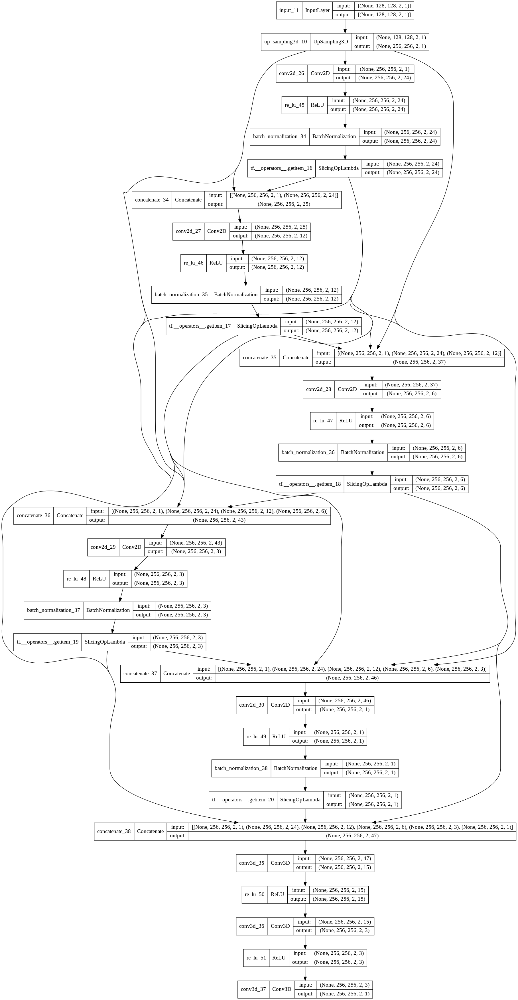

In [62]:
tfkl = tf.keras.layers

def densenet_superres(
    input_shape=(128,128,4,1),
    initial_filters=8,
    stacks=4,
    filter_scaling=0.25,
    squeezing_stages=3,
    l2=0,
    model_name='densenet_superres'):
  
    input_tensor = tf.keras.layers.Input(shape=input_shape)

    ups=tf.keras.layers.UpSampling3D(size=(2,2,1))(input_tensor)
    outputs = [ups]
    x = ups
    for i in range(stacks):
        x = tf.keras.layers.Conv2D(
            filters=initial_filters*filter_scaling**i,
            kernel_size=(3,3),
            padding="same",
            kernel_initializer=tfk.initializers.GlorotUniform(),
            kernel_regularizer=tfk.regularizers.l2(l2))(x)

        x = tf.keras.layers.ReLU()(x)      
        x = tf.keras.layers.BatchNormalization()(x)
        stack_output = x
        outputs.append(stack_output[-2:])
        x = tfkl.Concatenate(axis=4)(outputs)

    for j in range(3,squeezing_stages+3):
      x = tf.keras.layers.Conv3D(
          filters=(x.shape[-1])//j,
          kernel_size=(3,3,3),
          padding="same",
          kernel_initializer=tfk.initializers.GlorotUniform(),
          kernel_regularizer=tfk.regularizers.l2(l2))(x)
      x = tf.keras.layers.ReLU()(x) 
    x = tf.keras.layers.Conv3D(
          filters=1,
          kernel_size=(3,3,3),
          padding="same",
          kernel_initializer=tfk.initializers.GlorotUniform(),
          kernel_regularizer=tfk.regularizers.l2(l2))(x)

    output_tensor = x
    model = tf.keras.Model(inputs = [input_tensor], 
                              outputs = [output_tensor],name = model_name)
    return model

model = densenet_superres(
    input_shape      = (128,128,2,1),
    initial_filters  = 24,
    stacks           = 5,
    filter_scaling   = 0.5,
    l2               = 1e-8,
    squeezing_stages = 2,
    model_name='deltanet_superres'
)
print("TRAINABLE PARAMETERS: ","{:e}".format(count_params(model.trainable_weights)))
model.summary()
tf.keras.utils.plot_model(model,rankdir='UD',show_shapes=True)

# Training

Epoch 1/20
1568/1568 [==============================] - ETA: 0s - loss: 0.0048 - msle: 0.0024 - psnr: 25.8036 - ssim: 0.5991

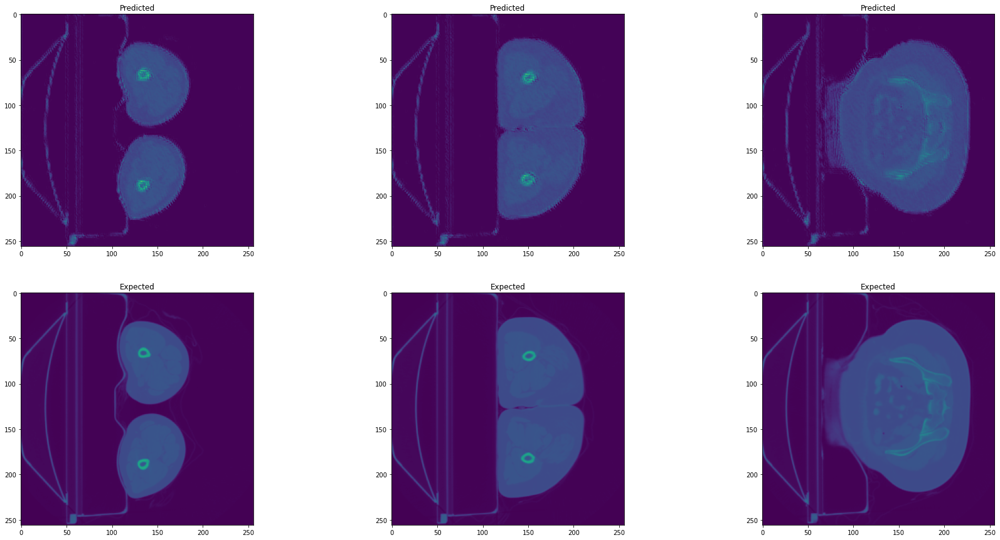

1568/1568 [==============================] - 81s 50ms/step - loss: 0.0048 - msle: 0.0024 - psnr: 25.8036 - ssim: 0.5991 - val_loss: 0.0016 - val_msle: 0.0010 - val_psnr: 28.2350 - val_ssim: 0.8227 - lr: 5.0000e-05
Epoch 2/20
1568/1568 [==============================] - ETA: 0s - loss: 0.0011 - msle: 7.0686e-04 - psnr: 30.3076 - ssim: 0.8376

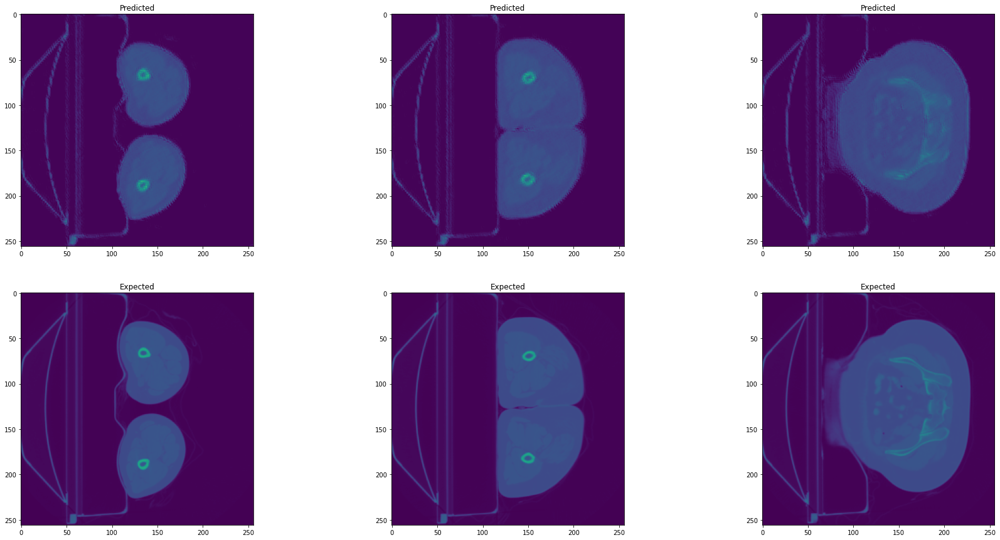

1568/1568 [==============================] - 77s 49ms/step - loss: 0.0011 - msle: 7.0686e-04 - psnr: 30.3076 - ssim: 0.8376 - val_loss: 0.0011 - val_msle: 6.8924e-04 - val_psnr: 30.0183 - val_ssim: 0.8636 - lr: 5.0000e-05
Epoch 3/20
1567/1568 [============================>.] - ETA: 0s - loss: 8.6030e-04 - msle: 5.6460e-04 - psnr: 31.4892 - ssim: 0.8720

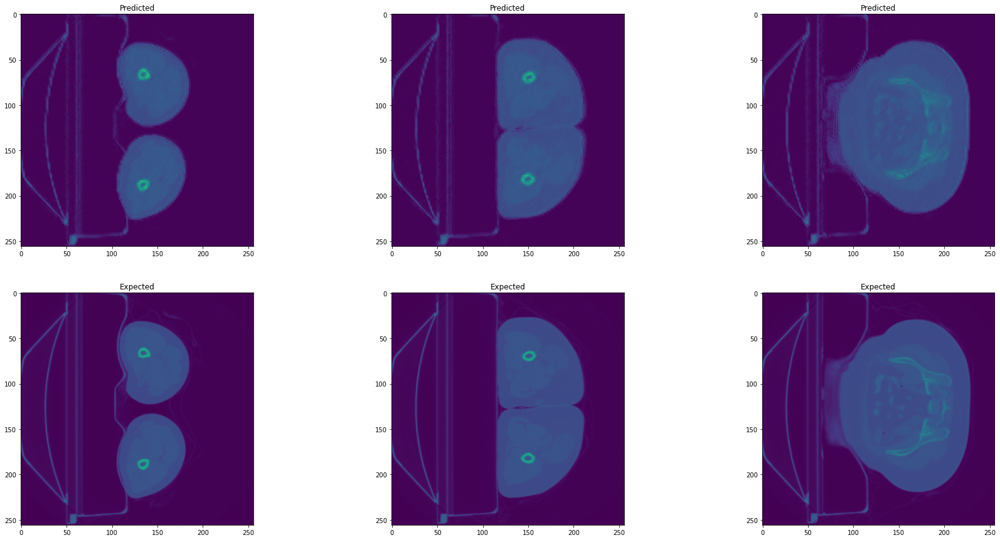

1568/1568 [==============================] - 77s 49ms/step - loss: 8.6029e-04 - msle: 5.6460e-04 - psnr: 31.4887 - ssim: 0.8720 - val_loss: 5.2078e-04 - val_msle: 3.5175e-04 - val_psnr: 33.1656 - val_ssim: 0.8873 - lr: 5.0000e-05
Epoch 4/20
1568/1568 [==============================] - ETA: 0s - loss: 7.5523e-04 - msle: 4.9249e-04 - psnr: 32.1553 - ssim: 0.8919

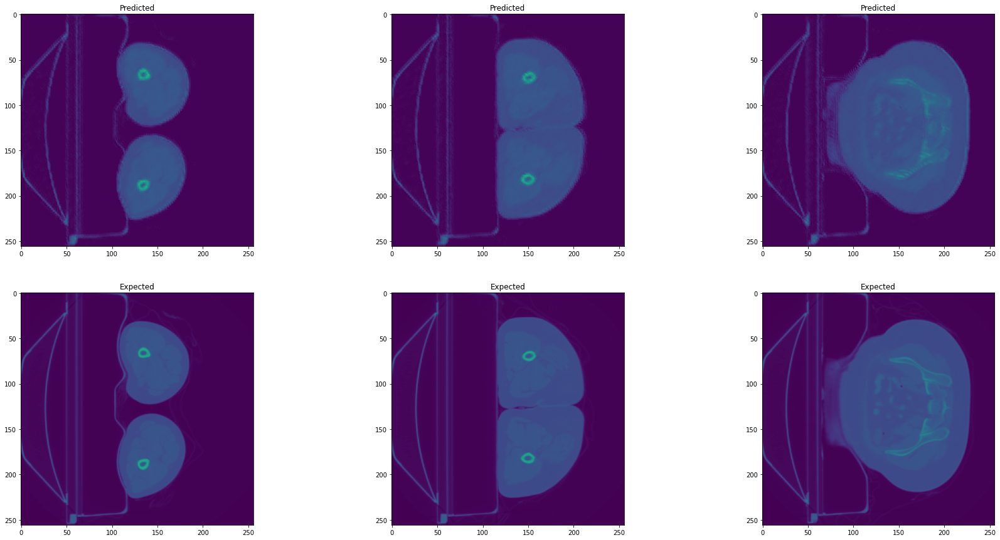

1568/1568 [==============================] - 77s 49ms/step - loss: 7.5523e-04 - msle: 4.9249e-04 - psnr: 32.1553 - ssim: 0.8919 - val_loss: 4.5035e-04 - val_msle: 3.0028e-04 - val_psnr: 33.7734 - val_ssim: 0.9035 - lr: 5.0000e-05
Epoch 5/20
1567/1568 [============================>.] - ETA: 0s - loss: 6.8062e-04 - msle: 4.4298e-04 - psnr: 32.7543 - ssim: 0.9036

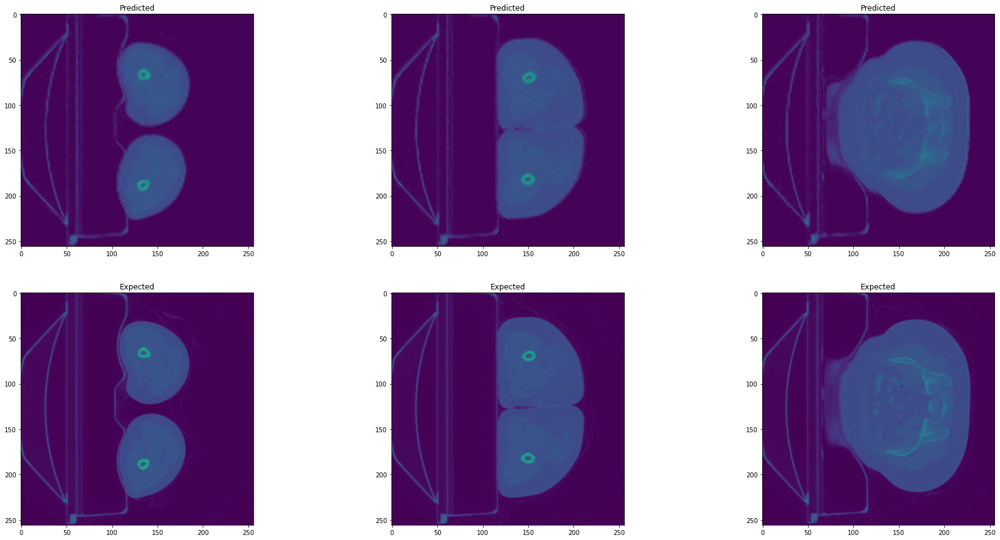

1568/1568 [==============================] - 77s 49ms/step - loss: 6.8057e-04 - msle: 4.4294e-04 - psnr: 32.7539 - ssim: 0.9036 - val_loss: 5.1390e-04 - val_msle: 3.2747e-04 - val_psnr: 33.3495 - val_ssim: 0.9062 - lr: 5.0000e-05
Epoch 6/20
1568/1568 [==============================] - ETA: 0s - loss: 6.1567e-04 - msle: 4.0092e-04 - psnr: 33.2214 - ssim: 0.9120

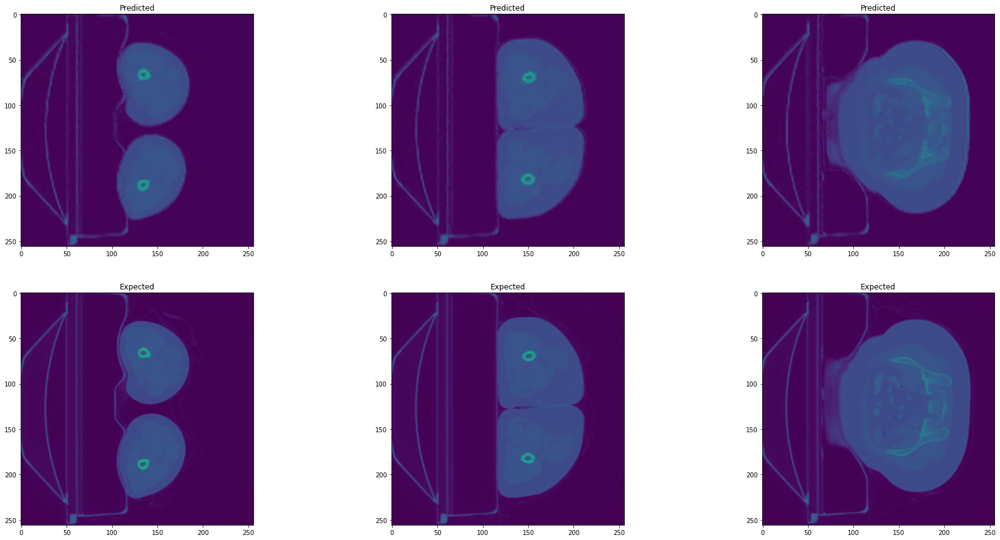

1568/1568 [==============================] - 77s 49ms/step - loss: 6.1567e-04 - msle: 4.0092e-04 - psnr: 33.2214 - ssim: 0.9120 - val_loss: 4.9036e-04 - val_msle: 3.1188e-04 - val_psnr: 33.5482 - val_ssim: 0.9116 - lr: 2.5000e-05
Epoch 7/20
1568/1568 [==============================] - ETA: 0s - loss: 5.9682e-04 - msle: 3.8789e-04 - psnr: 33.4270 - ssim: 0.9157

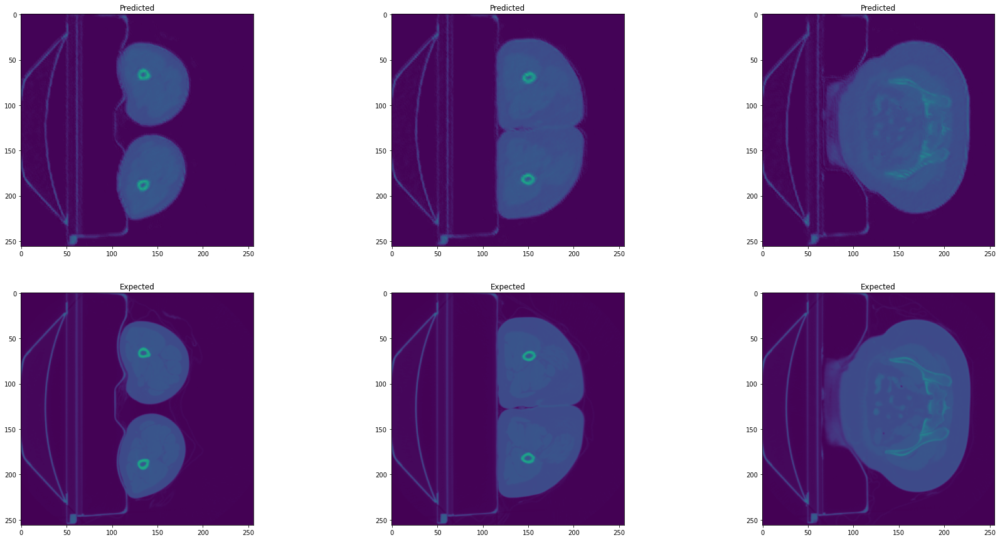

1568/1568 [==============================] - 77s 49ms/step - loss: 5.9682e-04 - msle: 3.8789e-04 - psnr: 33.4270 - ssim: 0.9157 - val_loss: 3.8954e-04 - val_msle: 2.5412e-04 - val_psnr: 34.4815 - val_ssim: 0.9185 - lr: 2.5000e-05
Epoch 8/20
1567/1568 [============================>.] - ETA: 0s - loss: 5.7377e-04 - msle: 3.7237e-04 - psnr: 33.6458 - ssim: 0.9196

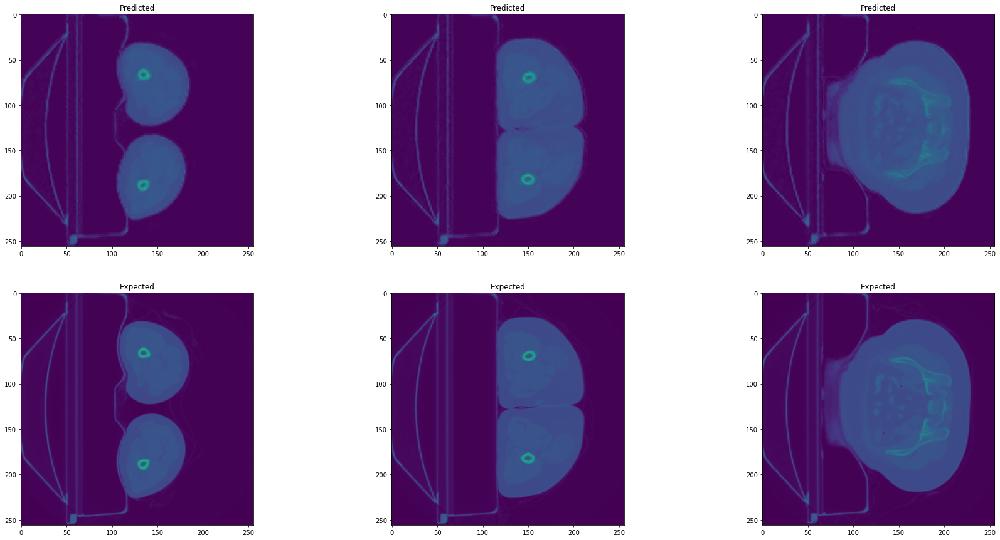

1568/1568 [==============================] - 77s 49ms/step - loss: 5.7379e-04 - msle: 3.7237e-04 - psnr: 33.6449 - ssim: 0.9196 - val_loss: 3.6456e-04 - val_msle: 2.3549e-04 - val_psnr: 34.8049 - val_ssim: 0.9229 - lr: 2.5000e-05
Epoch 9/20
1567/1568 [============================>.] - ETA: 0s - loss: 5.6014e-04 - msle: 3.6282e-04 - psnr: 33.7808 - ssim: 0.9225

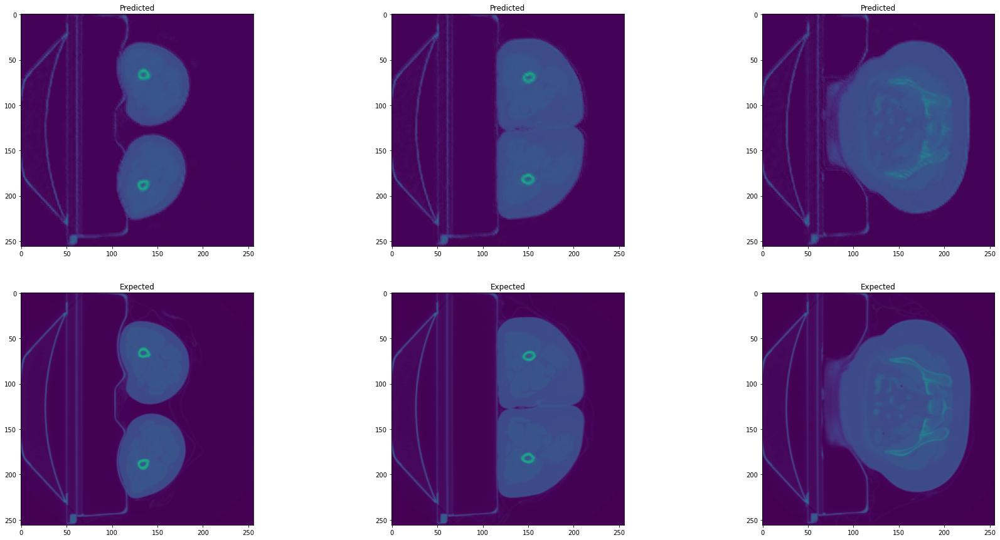

1568/1568 [==============================] - 77s 49ms/step - loss: 5.6000e-04 - msle: 3.6276e-04 - psnr: 33.7814 - ssim: 0.9225 - val_loss: 3.9423e-04 - val_msle: 2.5164e-04 - val_psnr: 34.5374 - val_ssim: 0.9243 - lr: 2.5000e-05
Epoch 10/20
1567/1568 [============================>.] - ETA: 0s - loss: 5.4438e-04 - msle: 3.5182e-04 - psnr: 33.9246 - ssim: 0.9251

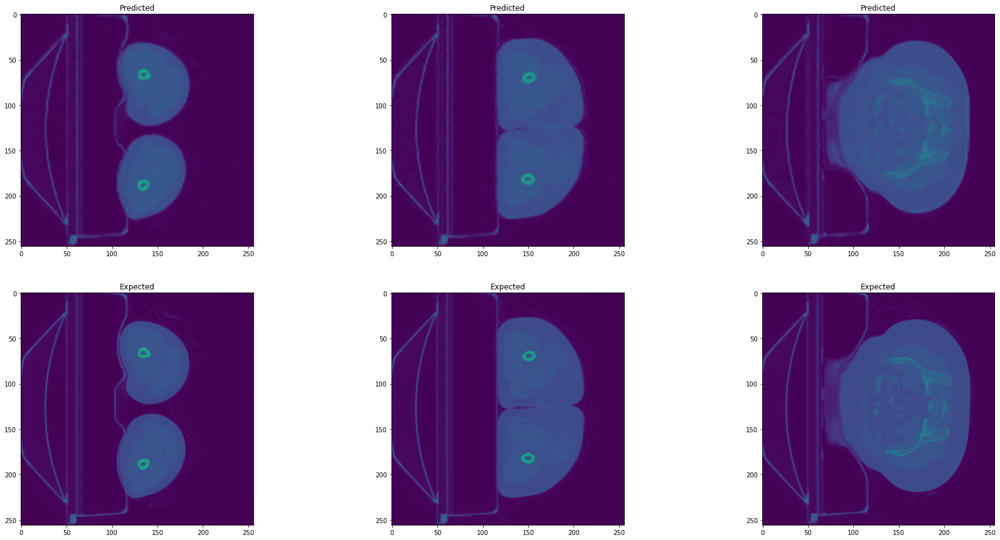

1568/1568 [==============================] - 77s 49ms/step - loss: 5.4415e-04 - msle: 3.5168e-04 - psnr: 33.9268 - ssim: 0.9251 - val_loss: 2.9308e-04 - val_msle: 1.9370e-04 - val_psnr: 35.7168 - val_ssim: 0.9303 - lr: 2.5000e-05
Epoch 11/20
1567/1568 [============================>.] - ETA: 0s - loss: 5.2221e-04 - msle: 3.3804e-04 - psnr: 34.1223 - ssim: 0.9274

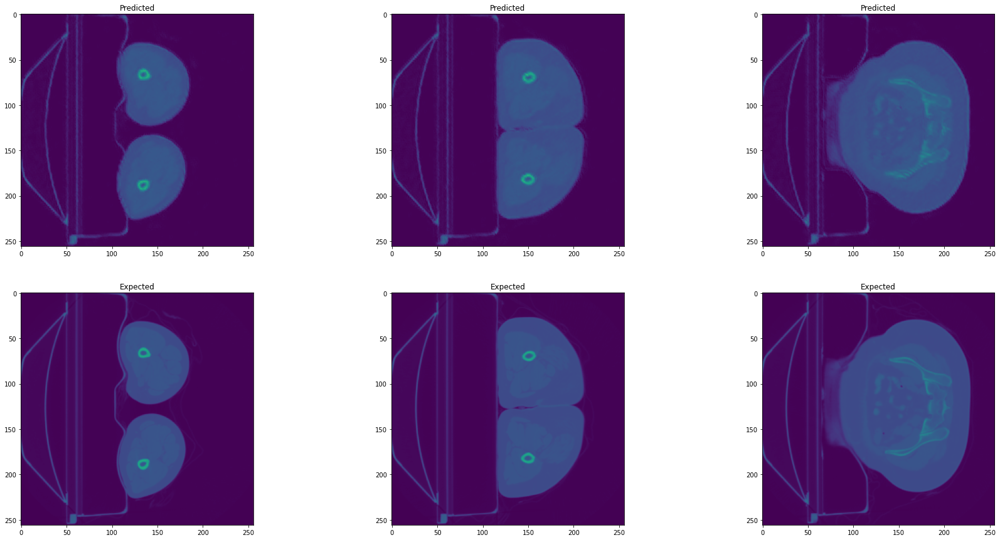

1568/1568 [==============================] - 77s 49ms/step - loss: 5.2204e-04 - msle: 3.3793e-04 - psnr: 34.1234 - ssim: 0.9274 - val_loss: 2.9045e-04 - val_msle: 1.9327e-04 - val_psnr: 35.7649 - val_ssim: 0.9279 - lr: 1.2500e-05
Epoch 12/20
1568/1568 [==============================] - ETA: 0s - loss: 5.1745e-04 - msle: 3.3463e-04 - psnr: 34.2370 - ssim: 0.9283

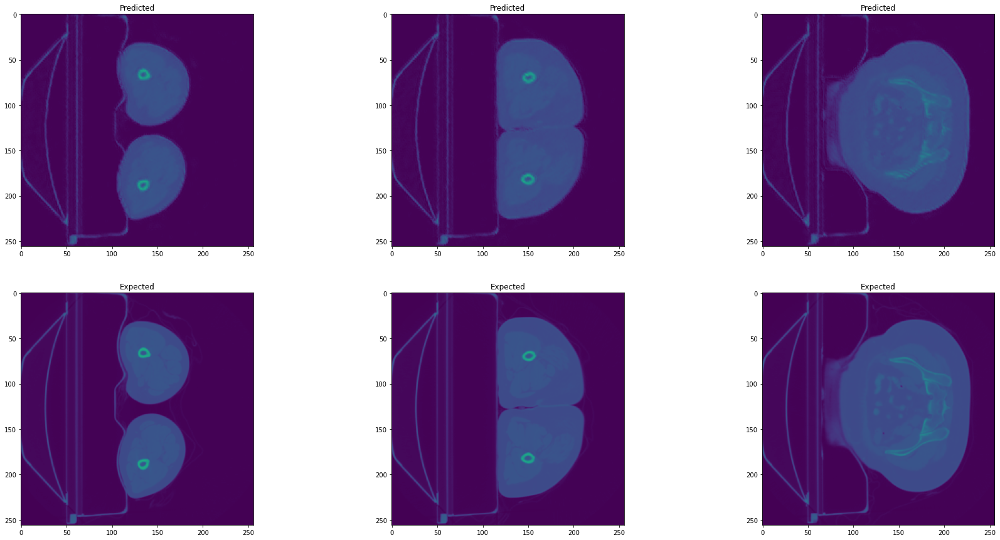

1568/1568 [==============================] - 78s 50ms/step - loss: 5.1745e-04 - msle: 3.3463e-04 - psnr: 34.2370 - ssim: 0.9283 - val_loss: 5.5342e-04 - val_msle: 3.3639e-04 - val_psnr: 33.1432 - val_ssim: 0.9249 - lr: 1.2500e-05
Epoch 13/20
1568/1568 [==============================] - ETA: 0s - loss: 5.1337e-04 - msle: 3.3178e-04 - psnr: 34.2590 - ssim: 0.9291

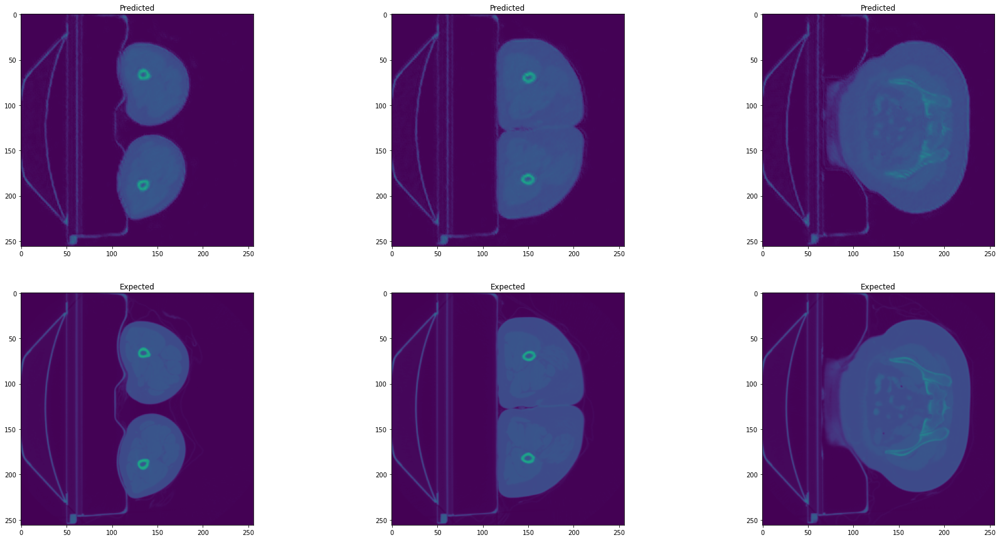

1568/1568 [==============================] - 78s 49ms/step - loss: 5.1337e-04 - msle: 3.3178e-04 - psnr: 34.2590 - ssim: 0.9291 - val_loss: 3.5827e-04 - val_msle: 2.2847e-04 - val_psnr: 34.9456 - val_ssim: 0.9276 - lr: 1.2500e-05
Epoch 14/20
1567/1568 [============================>.] - ETA: 0s - loss: 5.1018e-04 - msle: 3.2909e-04 - psnr: 34.3244 - ssim: 0.9302

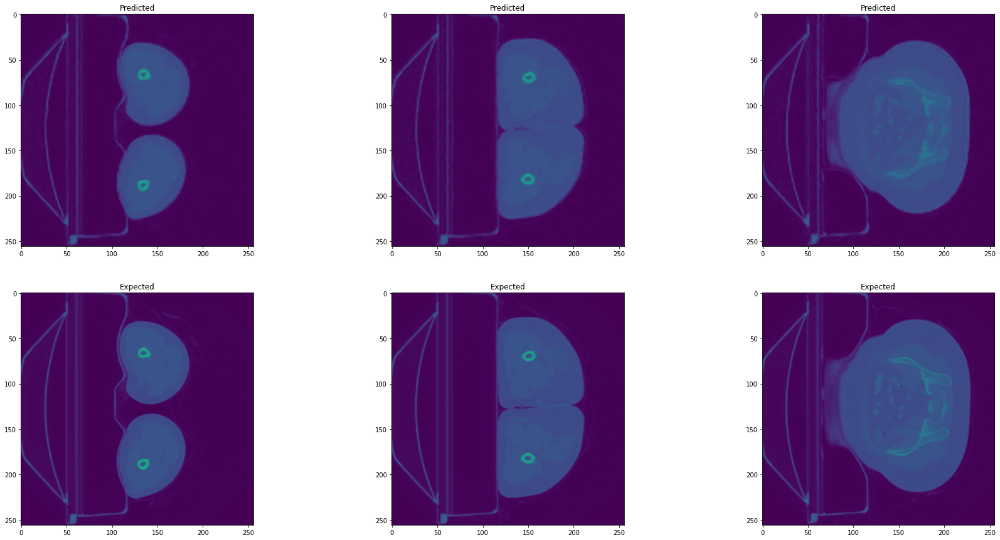

1568/1568 [==============================] - 77s 49ms/step - loss: 5.1005e-04 - msle: 3.2903e-04 - psnr: 34.3248 - ssim: 0.9301 - val_loss: 4.6165e-04 - val_msle: 2.8375e-04 - val_psnr: 33.9739 - val_ssim: 0.9287 - lr: 1.2500e-05
Epoch 15/20
1568/1568 [==============================] - ETA: 0s - loss: 5.0522e-04 - msle: 3.2580e-04 - psnr: 34.3943 - ssim: 0.9308

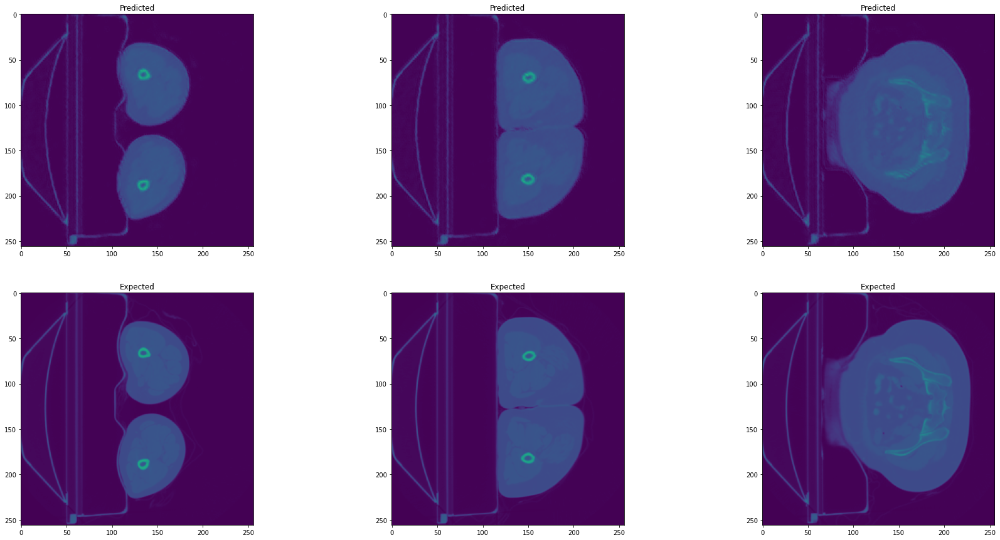

1568/1568 [==============================] - 78s 50ms/step - loss: 5.0522e-04 - msle: 3.2580e-04 - psnr: 34.3943 - ssim: 0.9308 - val_loss: 3.6391e-04 - val_msle: 2.2952e-04 - val_psnr: 34.9303 - val_ssim: 0.9299 - lr: 1.2500e-05
Epoch 16/20
1567/1568 [============================>.] - ETA: 0s - loss: 4.9197e-04 - msle: 3.1763e-04 - psnr: 34.4834 - ssim: 0.9319

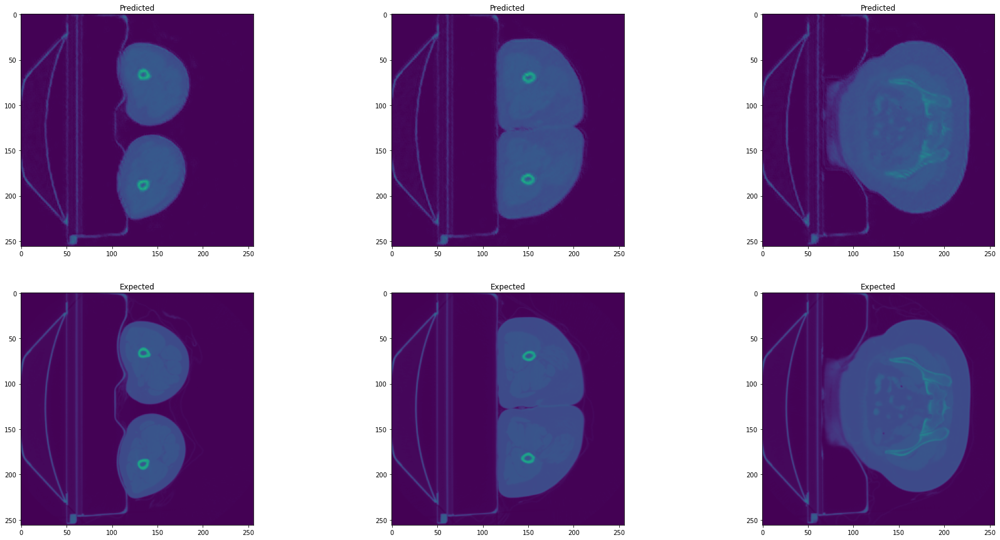

1568/1568 [==============================] - 78s 50ms/step - loss: 4.9205e-04 - msle: 3.1765e-04 - psnr: 34.4818 - ssim: 0.9319 - val_loss: 2.6937e-04 - val_msle: 1.7839e-04 - val_psnr: 36.0861 - val_ssim: 0.9318 - lr: 6.2500e-06
Epoch 17/20
1568/1568 [==============================] - ETA: 0s - loss: 4.8978e-04 - msle: 3.1602e-04 - psnr: 34.5109 - ssim: 0.9323

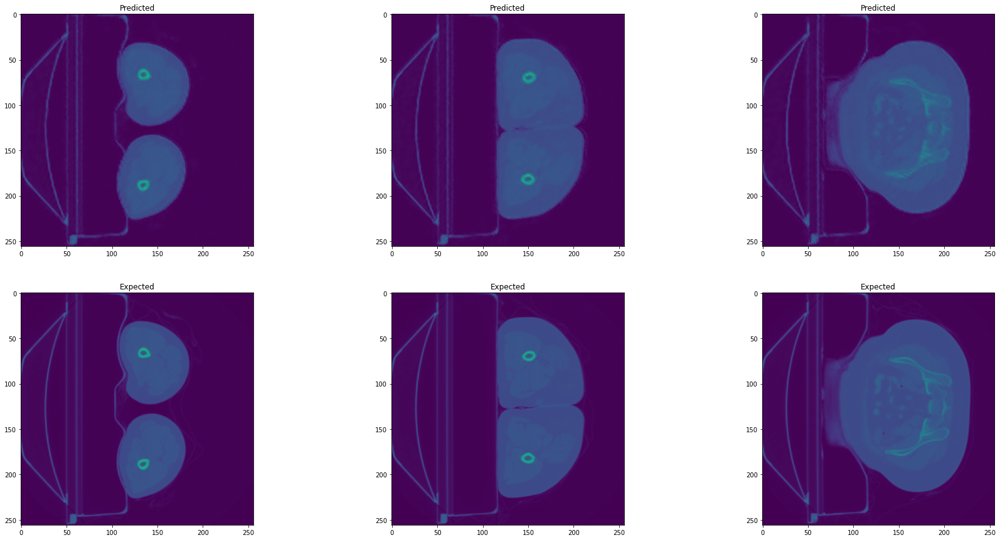

1568/1568 [==============================] - 79s 50ms/step - loss: 4.8978e-04 - msle: 3.1602e-04 - psnr: 34.5109 - ssim: 0.9323 - val_loss: 3.2316e-04 - val_msle: 2.0622e-04 - val_psnr: 35.3878 - val_ssim: 0.9333 - lr: 6.2500e-06
Epoch 18/20
1568/1568 [==============================] - ETA: 0s - loss: 4.8860e-04 - msle: 3.1512e-04 - psnr: 34.5544 - ssim: 0.9327

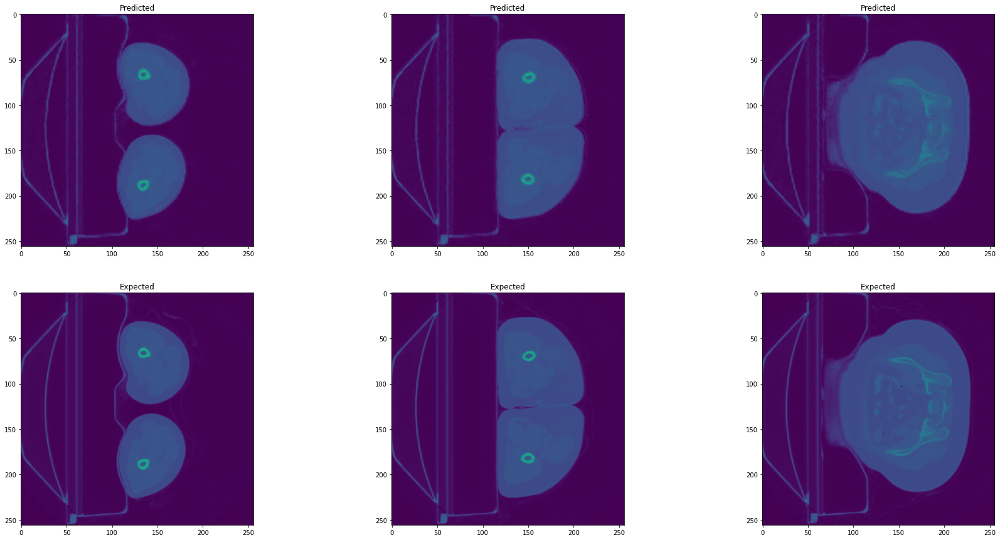

1568/1568 [==============================] - 79s 50ms/step - loss: 4.8860e-04 - msle: 3.1512e-04 - psnr: 34.5544 - ssim: 0.9327 - val_loss: 3.1296e-04 - val_msle: 2.0130e-04 - val_psnr: 35.5340 - val_ssim: 0.9312 - lr: 6.2500e-06
Epoch 19/20
1568/1568 [==============================] - ETA: 0s - loss: 4.8634e-04 - msle: 3.1360e-04 - psnr: 34.5515 - ssim: 0.9331

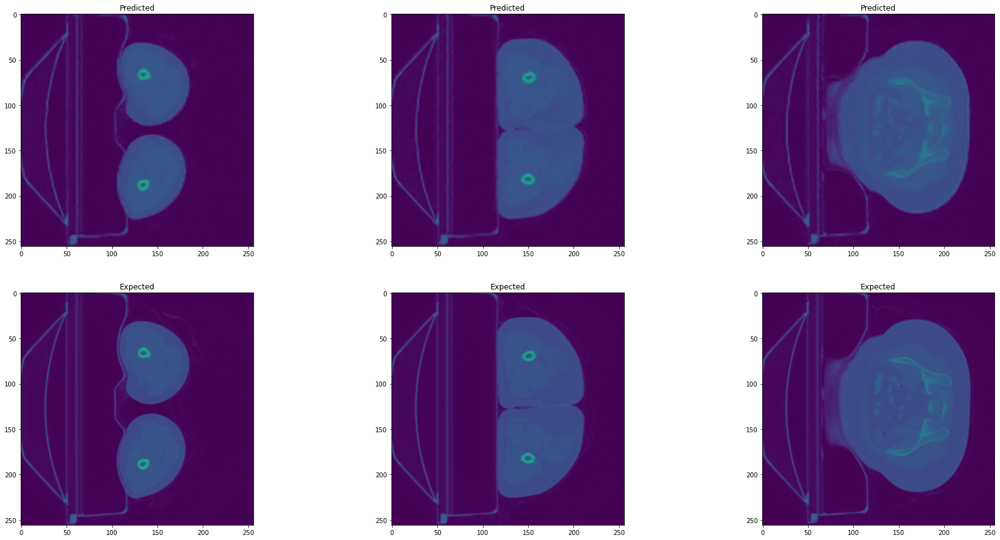

1568/1568 [==============================] - 79s 50ms/step - loss: 4.8634e-04 - msle: 3.1360e-04 - psnr: 34.5515 - ssim: 0.9331 - val_loss: 2.7406e-04 - val_msle: 1.7930e-04 - val_psnr: 36.0536 - val_ssim: 0.9349 - lr: 6.2500e-06
Epoch 20/20
1567/1568 [============================>.] - ETA: 0s - loss: 4.8614e-04 - msle: 3.1324e-04 - psnr: 34.5897 - ssim: 0.9334

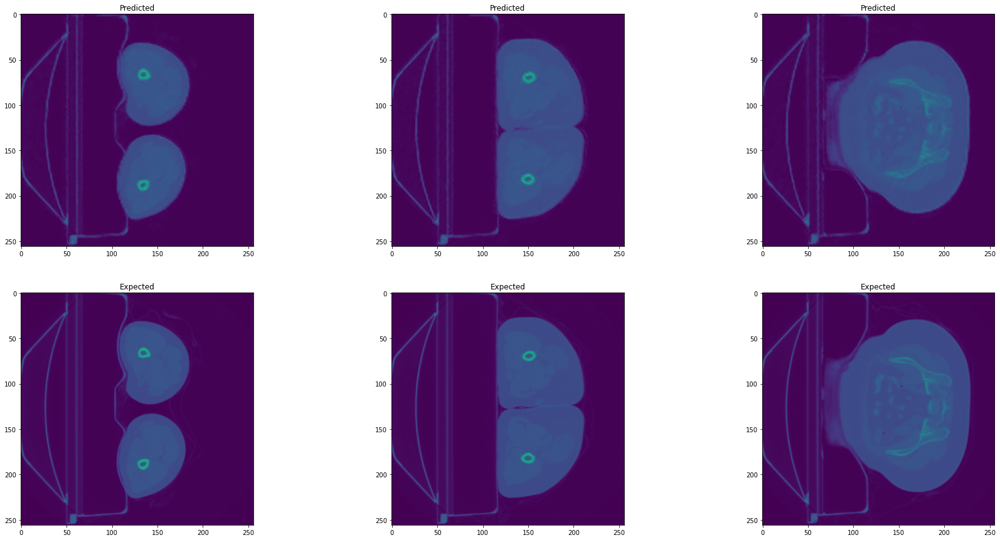

1568/1568 [==============================] - 79s 51ms/step - loss: 4.8600e-04 - msle: 3.1315e-04 - psnr: 34.5905 - ssim: 0.9334 - val_loss: 3.1581e-04 - val_msle: 2.0208e-04 - val_psnr: 35.5421 - val_ssim: 0.9316 - lr: 6.2500e-06


In [63]:
from tensorflow.keras import backend as K

def psnr(target_data, ref_data):
    return tf.image.psnr(target_data, ref_data, 1)

def ssim(target_data, ref_data):
    return tf.image.ssim(target_data, ref_data, 1)

def msle(target_data,ref_data):
    return tf.keras.metrics.mean_squared_logarithmic_error(target_data, ref_data)

import matplotlib.pyplot as plt
class show_activations(tf.keras.callbacks.Callback):
    def on_epoch_end(self, batch, logs=None):
        plt.figure(figsize=(30,15))
        for p,sl in enumerate([0,6,18]):
            out = self.model.predict(np.expand_dims(testVolumes_slice[sl],0))
            plt.subplot(2,3,p+1)
            plt.imshow(out[0,:,:,0,0],vmin=0,vmax=1)
            plt.title(f"Predicted")
            plt.subplot(2,3,p+4)
            plt.imshow(testLabels_slice[sl][:,:,0],vmin=0,vmax=1)
            plt.title(f"Expected")
        plt.show()
        del out
            

my_loss = 'mse'

my_metrics = []
my_metrics.append(msle)
my_metrics.append(psnr)
my_metrics.append(ssim)

my_callbacks = []
my_callbacks.append(show_activations())
my_callbacks.append(
    tf.keras.callbacks.EarlyStopping(
    monitor="val_psnr",
    patience=9,
    mode="max",
    restore_best_weights=True)
)

my_callbacks.append(
    tf.keras.callbacks.ModelCheckpoint(
        "checkpoint_{epoch:02d}.h5",
        monitor="val_loss",
        save_best_only=False,
        save_weights_only=False,
        mode="min",
    )
)
def lrscheduler(epochs,lr):
  if epochs%5==0: return lr/2
  else: return lr

my_callbacks.append(tfk.callbacks.LearningRateScheduler(lrscheduler))
my_callbacks.append(
    tf.keras.callbacks.ReduceLROnPlateau(
        monitor="val_psnr",
        factor=0.1,
        patience=5,
        verbose=1,
        mode="max"
    ),
)

LEARNING_RATE = 1e-4
BATCH_SIZE = 1
MAX_EPOCHS = 20

model.compile(
    optimizer = tf.keras.optimizers.Adam(LEARNING_RATE),
    loss      = my_loss,
    metrics   = my_metrics 
    )

# Run Model Training
monitoring = model.fit(
    x = trainVolumes_slice, 
    y = trainLabels_slice, 
    batch_size = BATCH_SIZE, 
    epochs = MAX_EPOCHS, 
    validation_data = (
        validationVolumes_slice,
        validationLabels_slice
    ),
    callbacks = my_callbacks) 

# Save the net
model.save("./model_fulltrained.h5")

Epoch 1/20
784/784 [==============================] - ETA: 0s - loss: 4.9169e-04 - msle: 3.1690e-04 - psnr: 34.5734 - ssim: 0.9340

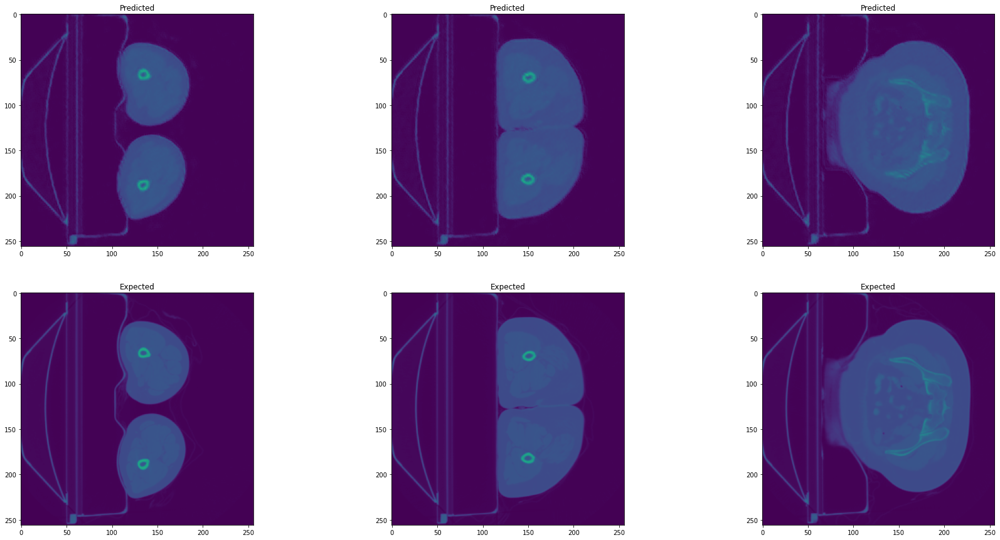

784/784 [==============================] - 69s 85ms/step - loss: 4.9169e-04 - msle: 3.1690e-04 - psnr: 34.5734 - ssim: 0.9340 - val_loss: 3.1912e-04 - val_msle: 2.0256e-04 - val_psnr: 35.4868 - val_ssim: 0.9346 - lr: 5.0000e-08
Epoch 2/20
784/784 [==============================] - ETA: 0s - loss: 4.9143e-04 - msle: 3.1678e-04 - psnr: 34.5858 - ssim: 0.9341

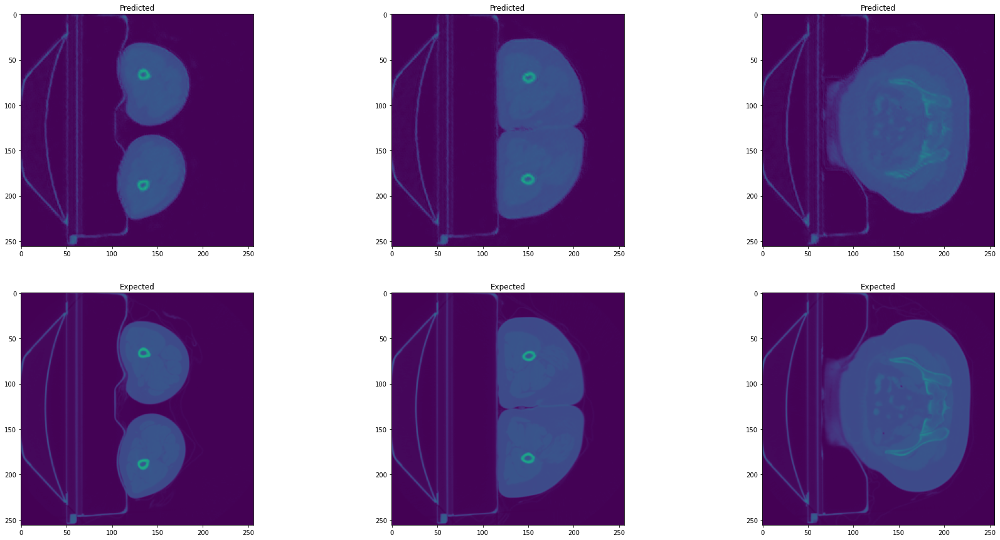

784/784 [==============================] - 65s 83ms/step - loss: 4.9143e-04 - msle: 3.1678e-04 - psnr: 34.5858 - ssim: 0.9341 - val_loss: 3.2477e-04 - val_msle: 2.0570e-04 - val_psnr: 35.4212 - val_ssim: 0.9345 - lr: 5.0000e-08
Epoch 3/20
784/784 [==============================] - ETA: 0s - loss: 4.9470e-04 - msle: 3.1875e-04 - psnr: 34.5494 - ssim: 0.9340

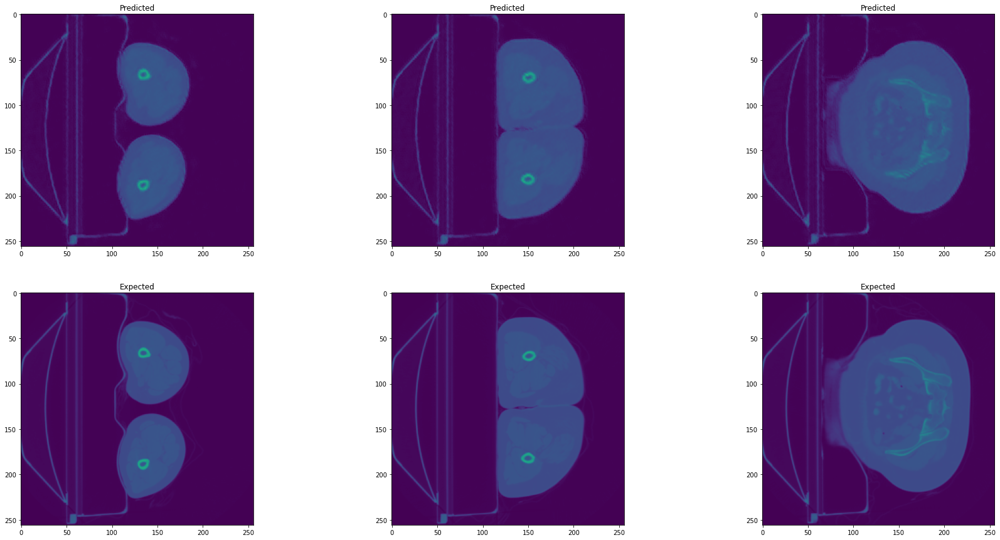

784/784 [==============================] - 65s 83ms/step - loss: 4.9470e-04 - msle: 3.1875e-04 - psnr: 34.5494 - ssim: 0.9340 - val_loss: 3.1614e-04 - val_msle: 2.0058e-04 - val_psnr: 35.5177 - val_ssim: 0.9351 - lr: 5.0000e-08
Epoch 4/20
784/784 [==============================] - ETA: 0s - loss: 4.8976e-04 - msle: 3.1571e-04 - psnr: 34.5888 - ssim: 0.9340

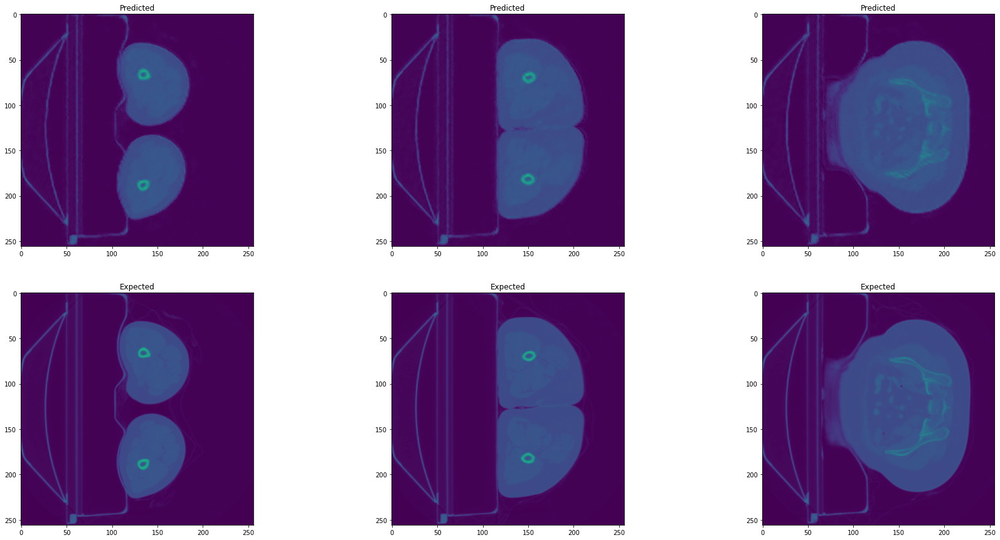

784/784 [==============================] - 65s 83ms/step - loss: 4.8976e-04 - msle: 3.1571e-04 - psnr: 34.5888 - ssim: 0.9340 - val_loss: 3.2122e-04 - val_msle: 2.0351e-04 - val_psnr: 35.4635 - val_ssim: 0.9345 - lr: 5.0000e-08
Epoch 5/20
784/784 [==============================] - ETA: 0s - loss: 4.9414e-04 - msle: 3.1815e-04 - psnr: 34.5449 - ssim: 0.9340

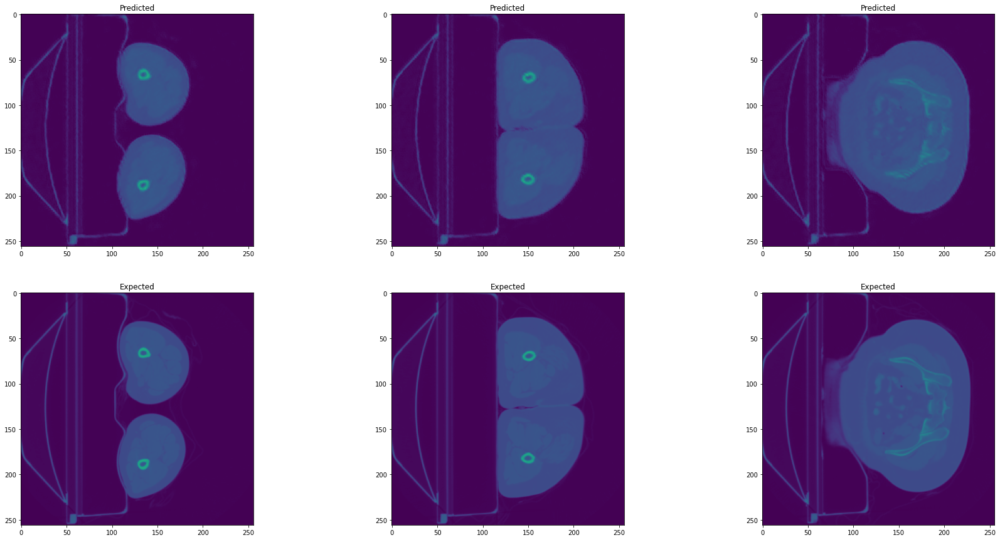

784/784 [==============================] - 66s 85ms/step - loss: 4.9414e-04 - msle: 3.1815e-04 - psnr: 34.5449 - ssim: 0.9340 - val_loss: 3.2730e-04 - val_msle: 2.0708e-04 - val_psnr: 35.3965 - val_ssim: 0.9343 - lr: 5.0000e-08
Epoch 6/20
784/784 [==============================] - ETA: 0s - loss: 4.8972e-04 - msle: 3.1574e-04 - psnr: 34.5702 - ssim: 0.9341

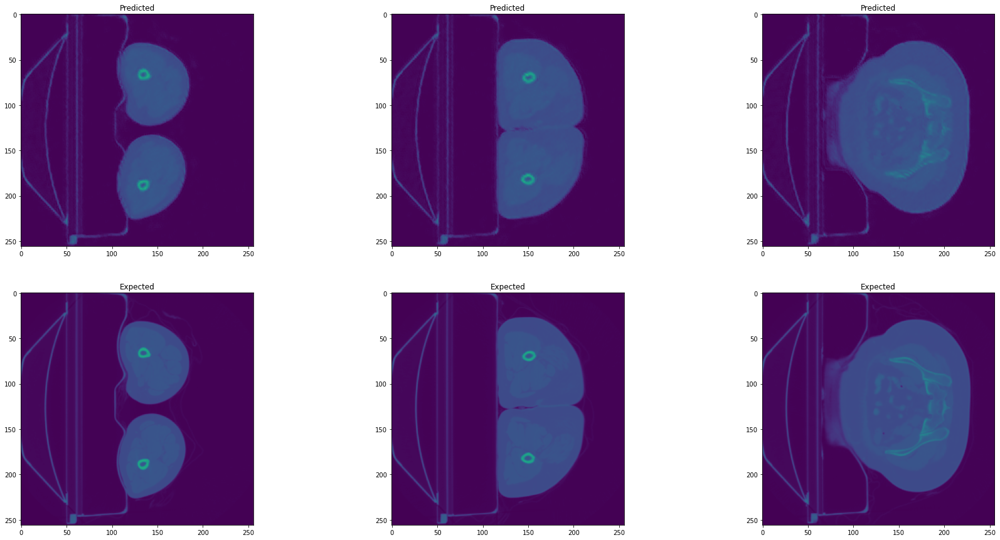

784/784 [==============================] - 65s 83ms/step - loss: 4.8972e-04 - msle: 3.1574e-04 - psnr: 34.5702 - ssim: 0.9341 - val_loss: 3.1849e-04 - val_msle: 2.0166e-04 - val_psnr: 35.4853 - val_ssim: 0.9351 - lr: 2.5000e-08
Epoch 7/20
784/784 [==============================] - ETA: 0s - loss: 4.9136e-04 - msle: 3.1669e-04 - psnr: 34.5734 - ssim: 0.9340

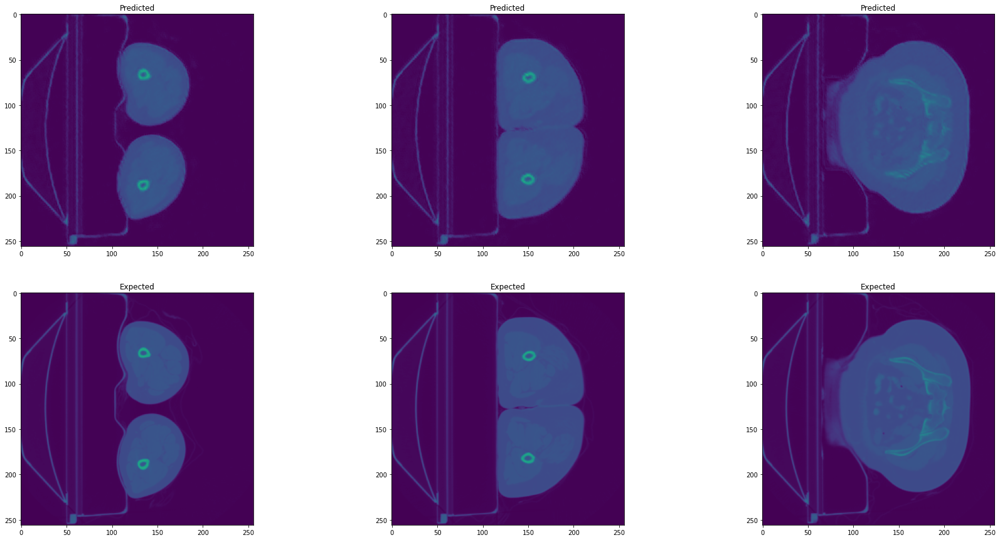

784/784 [==============================] - 65s 83ms/step - loss: 4.9136e-04 - msle: 3.1669e-04 - psnr: 34.5734 - ssim: 0.9340 - val_loss: 3.2284e-04 - val_msle: 2.0436e-04 - val_psnr: 35.4475 - val_ssim: 0.9347 - lr: 2.5000e-08
Epoch 8/20
784/784 [==============================] - ETA: 0s - loss: 4.9101e-04 - msle: 3.1637e-04 - psnr: 34.5689 - ssim: 0.9340

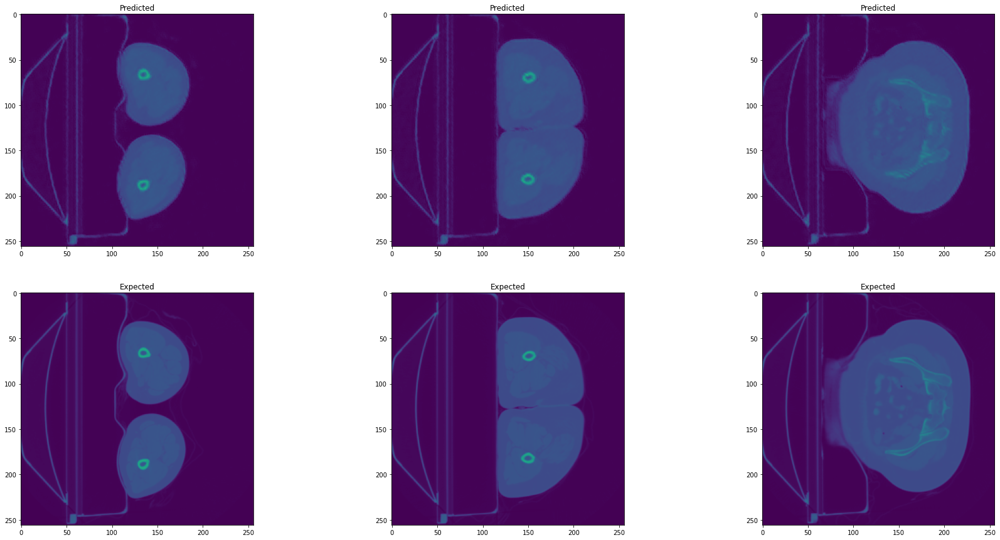


Epoch 00008: ReduceLROnPlateau reducing learning rate to 2.500000029215244e-09.
784/784 [==============================] - 65s 84ms/step - loss: 4.9101e-04 - msle: 3.1637e-04 - psnr: 34.5689 - ssim: 0.9340 - val_loss: 3.2519e-04 - val_msle: 2.0546e-04 - val_psnr: 35.4101 - val_ssim: 0.9346 - lr: 2.5000e-08
Epoch 9/20
784/784 [==============================] - ETA: 0s - loss: 4.9047e-04 - msle: 3.1625e-04 - psnr: 34.5746 - ssim: 0.9340

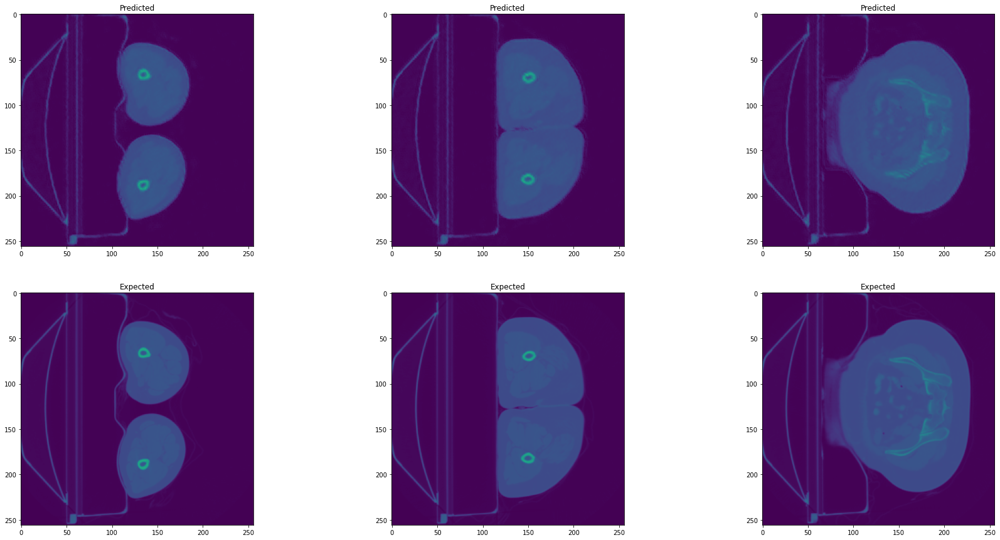

784/784 [==============================] - 65s 83ms/step - loss: 4.9047e-04 - msle: 3.1625e-04 - psnr: 34.5746 - ssim: 0.9340 - val_loss: 3.2717e-04 - val_msle: 2.0693e-04 - val_psnr: 35.4033 - val_ssim: 0.9342 - lr: 2.5000e-09
Epoch 10/20
784/784 [==============================] - ETA: 0s - loss: 4.9176e-04 - msle: 3.1682e-04 - psnr: 34.5650 - ssim: 0.9341

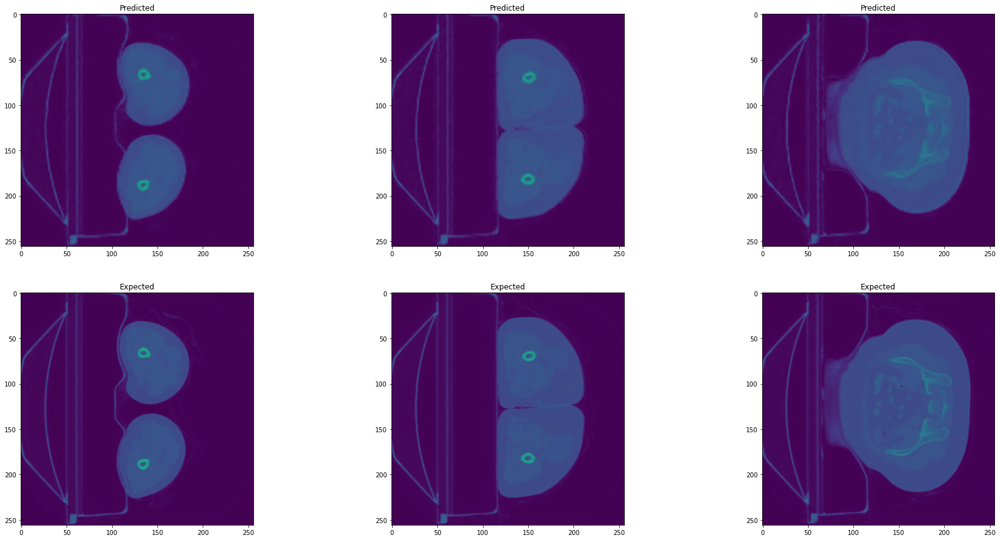

784/784 [==============================] - 65s 83ms/step - loss: 4.9176e-04 - msle: 3.1682e-04 - psnr: 34.5650 - ssim: 0.9341 - val_loss: 3.2011e-04 - val_msle: 2.0265e-04 - val_psnr: 35.4742 - val_ssim: 0.9350 - lr: 2.5000e-09
Epoch 11/20
784/784 [==============================] - ETA: 0s - loss: 4.8855e-04 - msle: 3.1500e-04 - psnr: 34.5844 - ssim: 0.9341

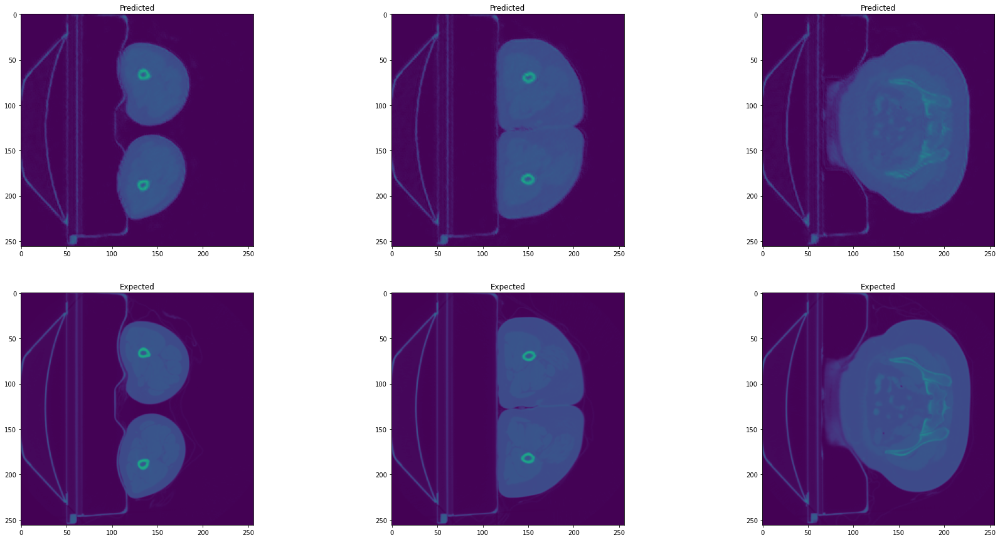

784/784 [==============================] - 65s 83ms/step - loss: 4.8855e-04 - msle: 3.1500e-04 - psnr: 34.5844 - ssim: 0.9341 - val_loss: 3.2406e-04 - val_msle: 2.0493e-04 - val_psnr: 35.4310 - val_ssim: 0.9347 - lr: 1.2500e-09
Epoch 12/20
784/784 [==============================] - ETA: 0s - loss: 4.9152e-04 - msle: 3.1670e-04 - psnr: 34.5583 - ssim: 0.9340

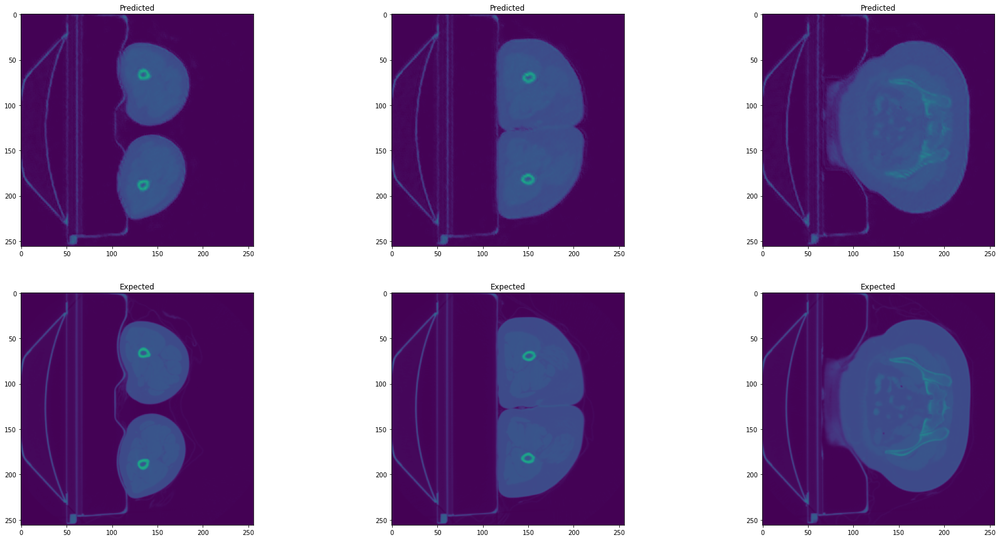

784/784 [==============================] - 65s 83ms/step - loss: 4.9152e-04 - msle: 3.1670e-04 - psnr: 34.5583 - ssim: 0.9340 - val_loss: 3.2263e-04 - val_msle: 2.0409e-04 - val_psnr: 35.4452 - val_ssim: 0.9348 - lr: 1.2500e-09


In [64]:
from tensorflow.keras import backend as K

def psnr(target_data, ref_data):
    return tf.image.psnr(target_data, ref_data, 1)

def ssim(target_data, ref_data):
    return tf.image.ssim(target_data, ref_data, 1)

def msle(target_data,ref_data):
    return tf.keras.metrics.mean_squared_logarithmic_error(target_data, ref_data)

import matplotlib.pyplot as plt
class show_activations(tf.keras.callbacks.Callback):
    def on_epoch_end(self, batch, logs=None):
        plt.figure(figsize=(30,15))
        for p,sl in enumerate([0,6,18]):
            out = self.model.predict(np.expand_dims(testVolumes_slice[sl],0))
            plt.subplot(2,3,p+1)
            plt.imshow(out[0,:,:,0,0],vmin=0,vmax=1)
            plt.title(f"Predicted")
            plt.subplot(2,3,p+4)
            plt.imshow(testLabels_slice[sl][:,:,0],vmin=0,vmax=1)
            plt.title(f"Expected")
        plt.show()
        del out
            

my_loss = 'mse'

my_metrics = []
my_metrics.append(msle)
my_metrics.append(psnr)
my_metrics.append(ssim)

my_callbacks = []
my_callbacks.append(show_activations())
my_callbacks.append(
    tf.keras.callbacks.EarlyStopping(
    monitor="val_psnr",
    patience=9,
    mode="max",
    restore_best_weights=True)
)

my_callbacks.append(
    tf.keras.callbacks.ModelCheckpoint(
        "checkpoint_{epoch:02d}.h5",
        monitor="val_loss",
        save_best_only=False,
        save_weights_only=False,
        mode="min",
    )
)
def lrscheduler(epochs,lr):
  if epochs%5==0: return lr/2
  else: return lr

my_callbacks.append(tfk.callbacks.LearningRateScheduler(lrscheduler))
my_callbacks.append(
    tf.keras.callbacks.ReduceLROnPlateau(
        monitor="val_psnr",
        factor=0.1,
        patience=5,
        verbose=1,
        mode="max"
    ),
)

LEARNING_RATE = 1e-7
BATCH_SIZE = 2
MAX_EPOCHS = 20

model.compile(
    optimizer = tf.keras.optimizers.Adam(LEARNING_RATE),
    loss      = my_loss,
    metrics   = my_metrics 
    )

# Run Model Training
monitoring = model.fit(
    x = trainVolumes_slice, 
    y = trainLabels_slice, 
    batch_size = BATCH_SIZE, 
    epochs = MAX_EPOCHS, 
    validation_data = (
        validationVolumes_slice,
        validationLabels_slice
    ),
    callbacks = my_callbacks) 

# Save the net
model.save("./model_fulltrained.h5")

Evaluating Test case #1


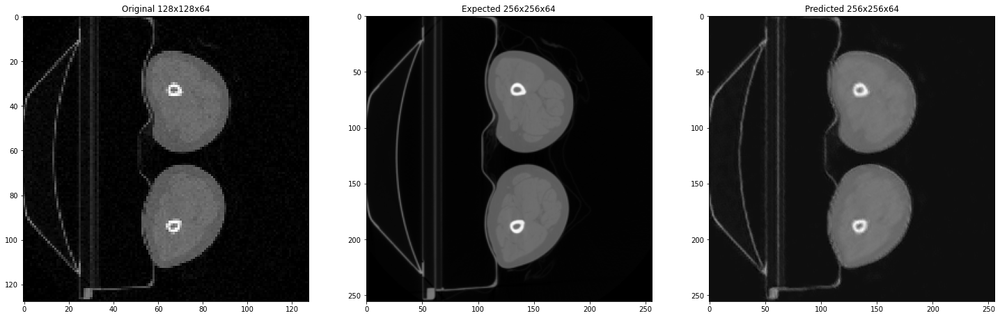

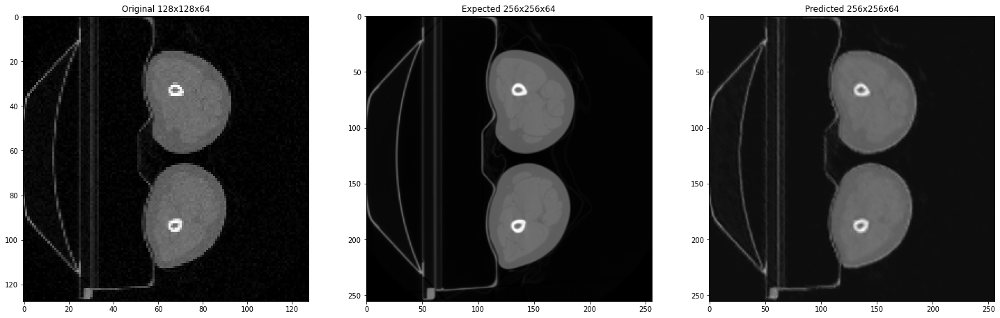

Evaluating Test case #2


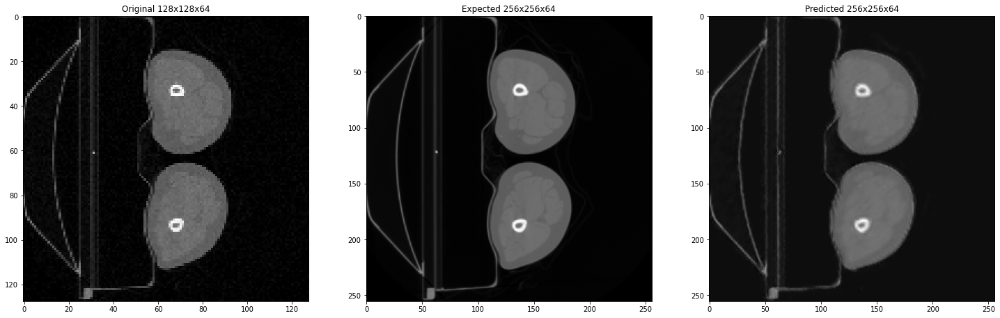

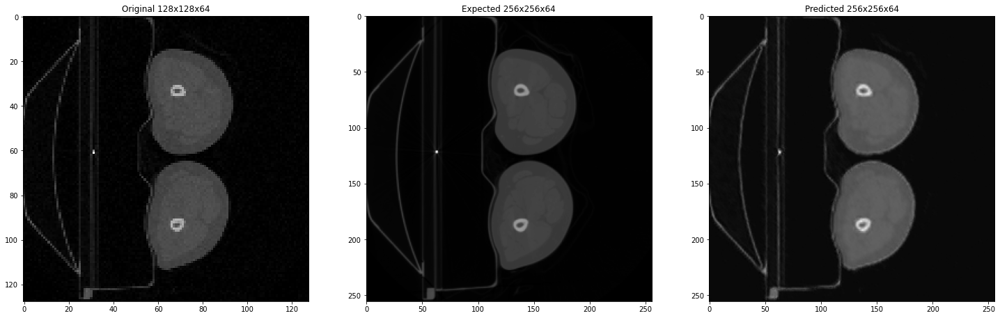

Evaluating Test case #3


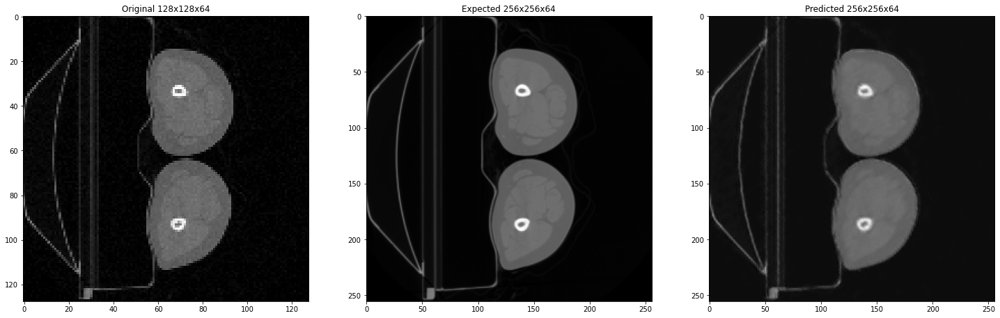

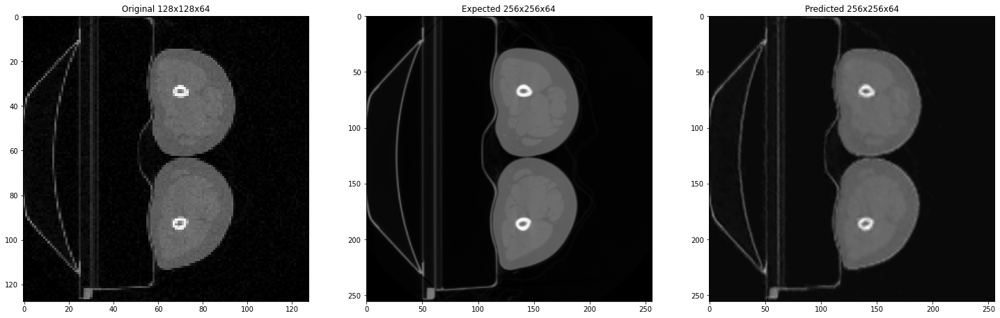

Evaluating Test case #4


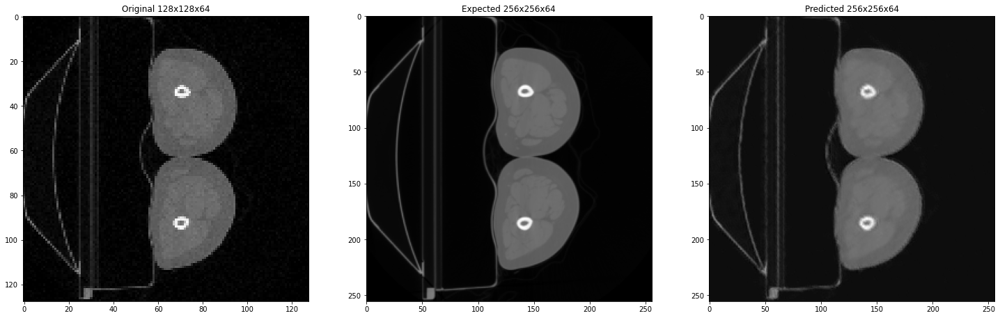

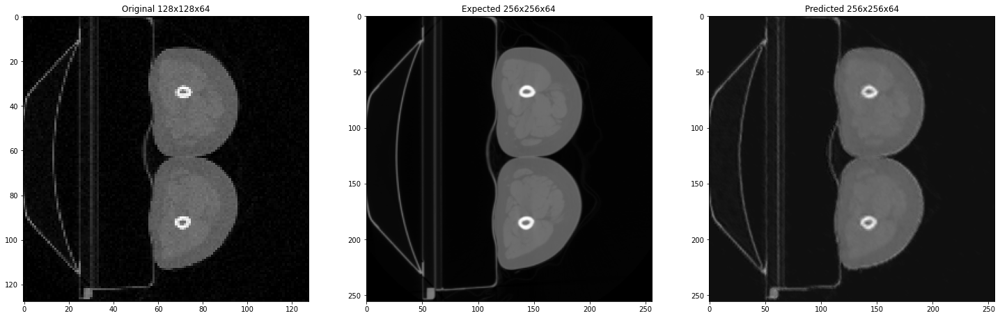

Evaluating Test case #5


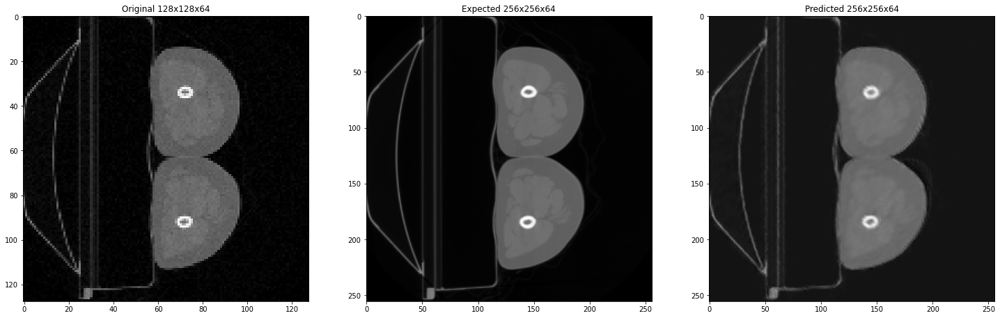

KeyboardInterrupt: ignored

In [71]:
# REDECLARING METRICS IF MODEL IS LOADED PRE-TRAINED
def psnr_loss(target_data, ref_data):
    return -1*tf.image.psnr(target_data, ref_data, 1)

def psnr(target_data, ref_data):
    return tf.image.psnr(target_data, ref_data, 1)

def ssim(target_data, ref_data):
    return tf.image.ssim(target_data, ref_data, 1)

my_loss = 'mse'

my_metrics = []
my_metrics.append(psnr)
my_metrics.append(ssim)

##############################################################################################

# If you want to load a pre-trained model*°
# Set this parameter 'True' only if you want to load another model, otherwise leave it 'False'
LOAD = False                    
MODEL_NAME = 'model_00.h5'      # The name of the model to load 
LEARNING_RATE = 1e-3
BATCH_SIZE = 1
MAX_EPOCHS = 50

if LOAD is True:
    #model_to_load = os.path.join(MODEL_PATH, MODEL_NAME)
    my_model = tf.keras.models.load_model('../model_final.h5',compile=False)
    print("Model loaded!")

    my_model.compile(
    optimizer = tf.keras.optimizers.Adam(LEARNING_RATE),
    loss      = my_loss,
    metrics   = my_metrics 
    )
    
PLOT = True
          
# just visualizing slice by slice:
if PLOT:
    for case in range(len(testVolumes_slice)//3):
        print(f"Evaluating Test case #{case+1}")
        prediction = model.predict(np.expand_dims(testVolumes_slice[case],0))
        #print(f"PSNR={psnr(testLabels_slice[case].astype('float32'), prediction.astype('float32'))} - SSIM={ssim(testLabels_slice[case, :, :, :].astype('float32'), prediction[0,:, :, :].astype('float32'))}")
        for i in range(0, 2):
            fig = plt.figure(figsize = (25,17))
            plt.subplot(1, 3, 1)
            plt.imshow(testVolumes_slice[case, :, :, i], cmap = 'gray')
            plt.title("Original 128x128x64")
            plt.subplot(1, 3, 2)
            plt.imshow(testLabels_slice[case, :, :, i], cmap = 'gray')
            plt.title("Expected 256x256x64")
            plt.subplot(1, 3, 3)
            plt.imshow(prediction[0,:, :,i,0], cmap = 'gray')
            plt.title(f"Predicted 256x256x64")
            plt.show(fig)

In [ ]:
print(my_model.evaluate(x = testVolumes_slice, y = testLabels_slice))